<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Analysis-of-missing-values" data-toc-modified-id="Analysis-of-missing-values-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Analysis of missing values</a></span><ul class="toc-item"><li><span><a href="#Graphical-analysis" data-toc-modified-id="Graphical-analysis-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Graphical analysis</a></span></li><li><span><a href="#Features-with-least-/-most-missing-values" data-toc-modified-id="Features-with-least-/-most-missing-values-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Features with least / most missing values</a></span></li><li><span><a href="#Categoricals" data-toc-modified-id="Categoricals-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Categoricals</a></span></li><li><span><a href="#Binary-Features" data-toc-modified-id="Binary-Features-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Binary Features</a></span></li></ul></li><li><span><a href="#Imputation-strategies" data-toc-modified-id="Imputation-strategies-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Imputation strategies</a></span><ul class="toc-item"><li><span><a href="#KNN-imputation-with-missingpy" data-toc-modified-id="KNN-imputation-with-missingpy-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>KNN imputation with missingpy</a></span></li><li><span><a href="#Iterative-imputation-with-fancyimpute" data-toc-modified-id="Iterative-imputation-with-fancyimpute-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Iterative imputation with fancyimpute</a></span><ul class="toc-item"><li><span><a href="#Study-of-the-variance-in-imputed-data-sets" data-toc-modified-id="Study-of-the-variance-in-imputed-data-sets-2.2.1"><span class="toc-item-num">2.2.1&nbsp;&nbsp;</span>Study of the variance in imputed data sets</a></span></li></ul></li><li><span><a href="#Simple-Imputation" data-toc-modified-id="Simple-Imputation-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Simple Imputation</a></span><ul class="toc-item"><li><span><a href="#Categorical-features" data-toc-modified-id="Categorical-features-2.3.1"><span class="toc-item-num">2.3.1&nbsp;&nbsp;</span>Categorical features</a></span></li><li><span><a href="#Binary-features" data-toc-modified-id="Binary-features-2.3.2"><span class="toc-item-num">2.3.2&nbsp;&nbsp;</span>Binary features</a></span></li><li><span><a href="#numeric[&quot;data&quot;]-features" data-toc-modified-id="numeric[&quot;data&quot;]-features-2.3.3"><span class="toc-item-num">2.3.3&nbsp;&nbsp;</span>numeric["data"] features</a></span></li></ul></li></ul></li></ul></div>

In [1]:
%load_ext autoreload

In [2]:
%run ./common_init.ipynb

/data/anaconda/envs/py36/lib/python3.6/site-packages/sklearn/externals/six.py:31: DeprecationWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", DeprecationWarning)
/data/anaconda/envs/py36/lib/python3.6/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


<Figure size 432x288 with 0 Axes>

Setup logging to file: out.log
Figure output directory saved in figure_output at /home/datarian/OneDrive/unine/Master_Thesis/ma-thesis-report/figures
 cwd: /data/home/datarian/git/master-thesis-msc-statistics/code


In [3]:
%autoreload 2
import numpy as np
from sklearn.impute import SimpleImputer
import pickle

# Load kdd98 modules
import kdd98.data_handler as dh
from kdd98.config import Config

from fancyimpute import KNN, IterativeImputer, BiScaler

Using TensorFlow backend.


In [4]:
IMAGES_PATH = pathlib.Path(figure_output/'imputation')

pathlib.Path(IMAGES_PATH).mkdir(parents=True, exist_ok=True)

sns.set_palette(Config.get("qual_palette"))
sns.set_context("talk")

plt.rcParams['figure.figsize'] = (1.618*8, 8)

def save_fig(fig_id, tight_layout=True, fig_extension=["pdf", "png"], resolution=300):
    if tight_layout:
        plt.tight_layout()
    [plt.savefig(pathlib.Path(IMAGES_PATH, fig_id + "." + f), 
                 format=f,
                 dpi=resolution,
                 transparent=True,
                 bbox_inches='tight') for f in fig_extension]

In [6]:
data_provider = dh.KDD98DataProvider("cup98LRN.txt")

Before encoding categorical features

In [7]:
cleaned = data_provider.cleaned_data

With onehot / binary encoded categories and other feature engineering (zip codes to coordinates, etc.)

In [8]:
numeric = data_provider.numeric_data

The following helper function filters out feature names that were dropped during preprocessing. This prevents errors when retrieving data.

In [9]:
def filter_features(features, dataframe):
    return [f for f in features if f in dataframe.columns.values.tolist()]

# Analysis of missing values

A look at the data after feature preprocessing. Sparse features are already removed at this stage, meaning all features have at most 90 % missing values.

## Graphical analysis

Shown is the complete data set, examples on the y-axis, features on the x-axis. White cells are missing values.

The large block of complete features is the US census data.

In [10]:
import missingno as msno

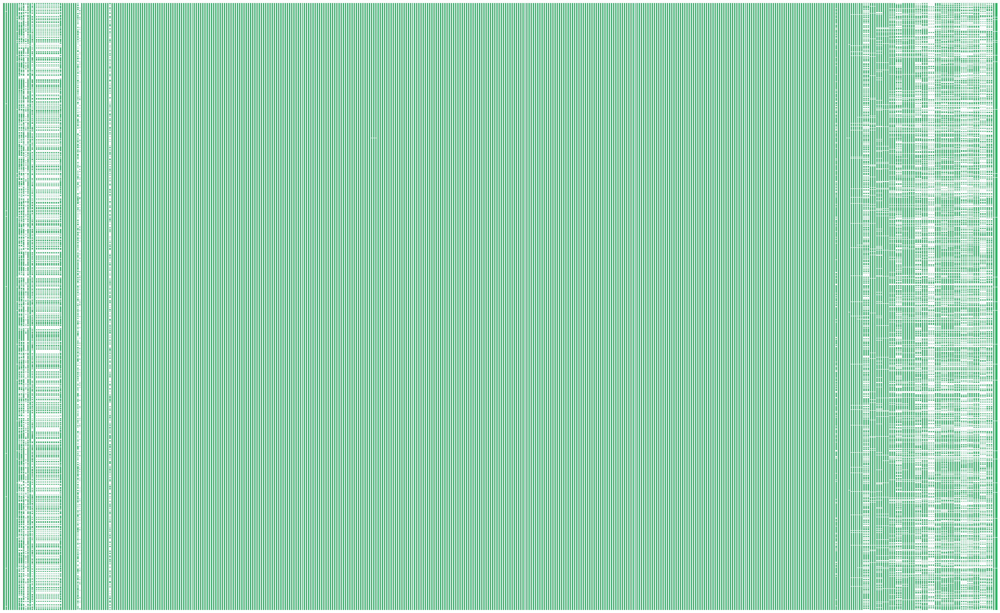

In [11]:
ax = msno.matrix(cleaned["data"], figsize=(20*1.618, 20), sparkline=False, inline=False, color=list(Config.get("qual_palette")[3]))
ax.set_yticks([])
save_fig("missing-matrix")

In [12]:
plt.rcParams['figure.figsize'] = (1.618*8, 8)

## Features with least / most missing values 

In [13]:
def count_missing(series):
    if series.dtypes == 'object':
        return len(series.loc[series == 'nan'])
    else:
        return series.isna().sum()

In [14]:
missing_in_feature = cleaned["data"].apply(count_missing, axis=0)

In [15]:
most_missing = missing_in_feature.sort_values(ascending=False).head(40)
fewest_missing = missing_in_feature.sort_values()
fewest_missing = fewest_missing[fewest_missing > 0.0].head(40)

The 20 features having the most missing values. There are many missing values for two RFA features (recency, frequency and amount of donations), simply because most examples did not donate in these campaigns. `PUB*` features are counters for how many times examples responded to fund raising mailings from other organisations.

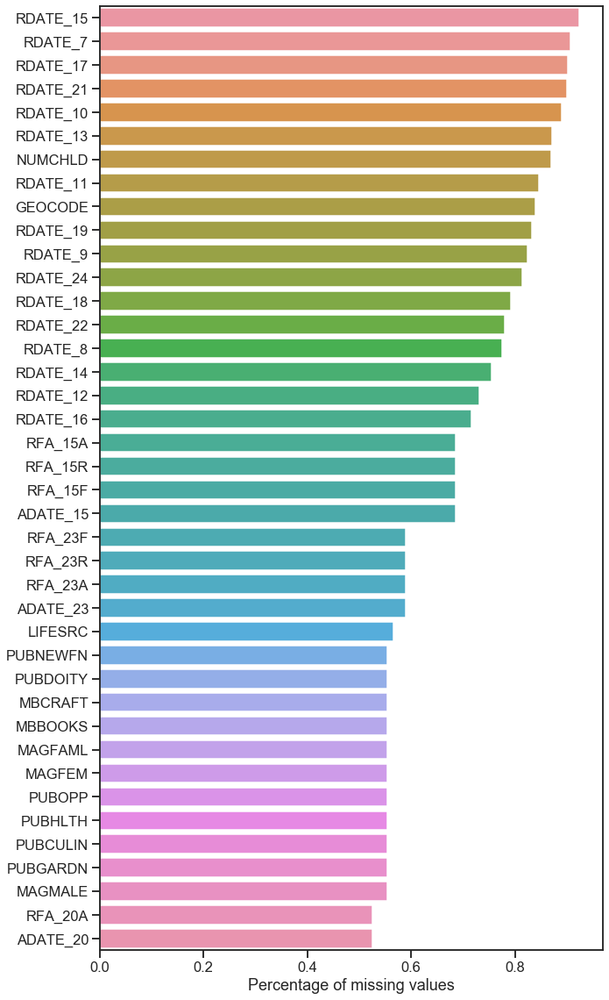

In [16]:
plt.rcParams['figure.figsize'] = (10, 1.618*10)
fig = sns.barplot(y=most_missing.index, x=most_missing/len(numeric["data"].index))
fig.set(xlabel = "Percentage of missing values")
save_fig("most-missing")

The fewest missing values (for features that have $\gt 0$ missing values) occur in US census features and interestingly 7 of the past campaigns in which it appears that a lot of examples have donated.

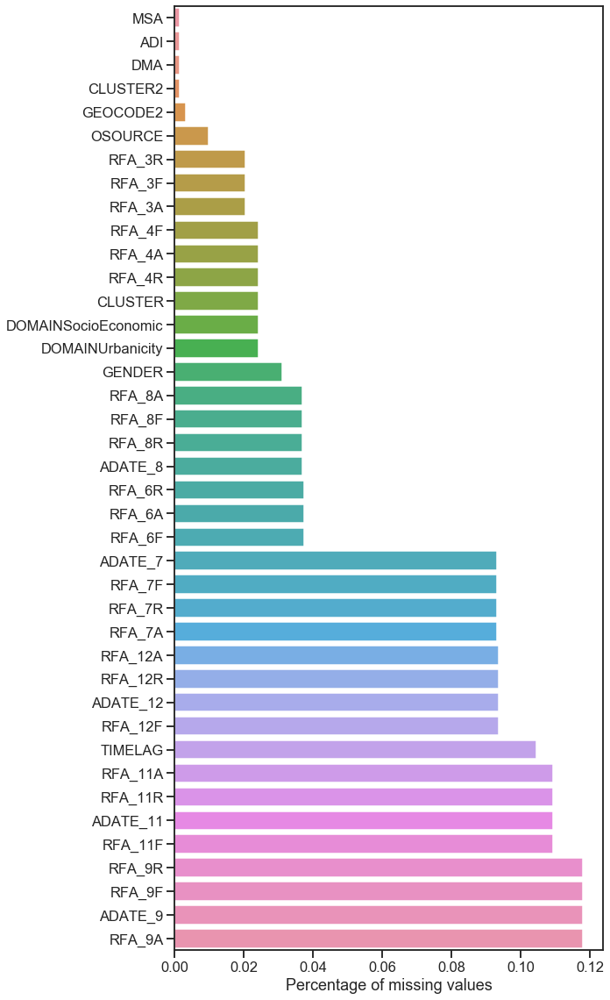

In [17]:
fig = sns.barplot(x=fewest_missing/len(numeric["data"].index),
            y=fewest_missing.index,)
fig.set(xlabel = "Percentage of missing values")
save_fig("fewest-missing")

## Categoricals

Below, an overview of the percentage of missing vales for categorical features is shown. The range is quite wide, but most of the features have less than 40 % missing values.

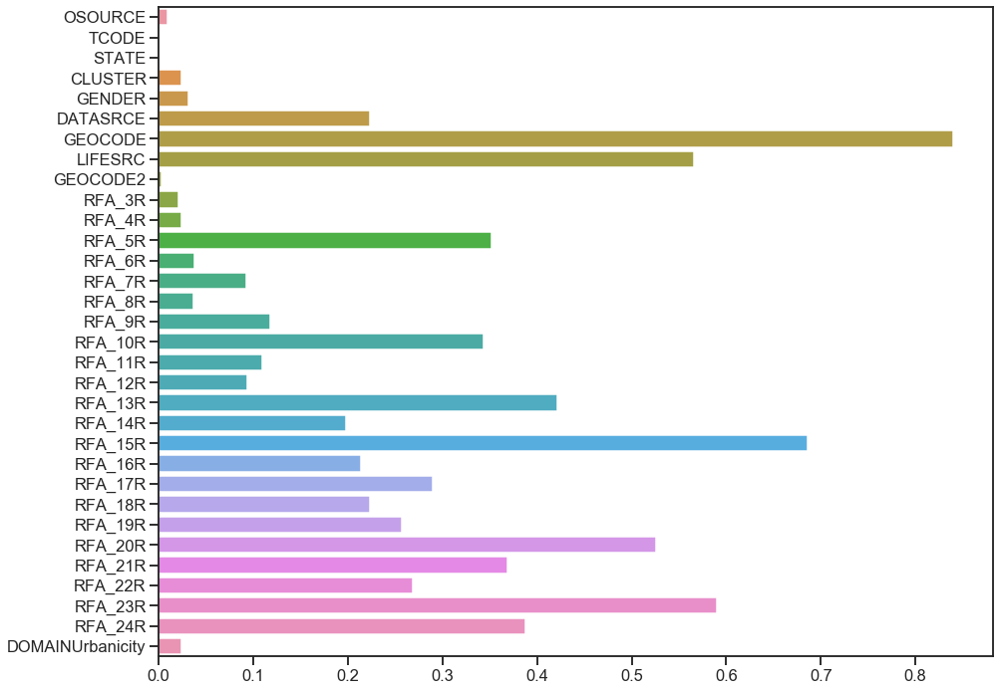

In [18]:
categoricals = cleaned["data"].select_dtypes(include="category")
plt.rcParams['figure.figsize'] = (15, 12)
sns.barplot(y=categoricals.columns, x=1-categoricals.count()/len(categoricals.index))
plt.xlabel = "Percentage of missing values."

## Binary Features

These features are indicators. Most have no missing values, which is attributed to cleaning steps during preprocessing. There, it was decided that for the interest features, which make up most of this block of data, a missing value indicates no interest.

As is evident, for the two remaining features with missing values, less than 30% is missing.

In [19]:
binary = cleaned["data"].loc[:,filter_features(dh.BINARY_FEATURES, cleaned["data"])]

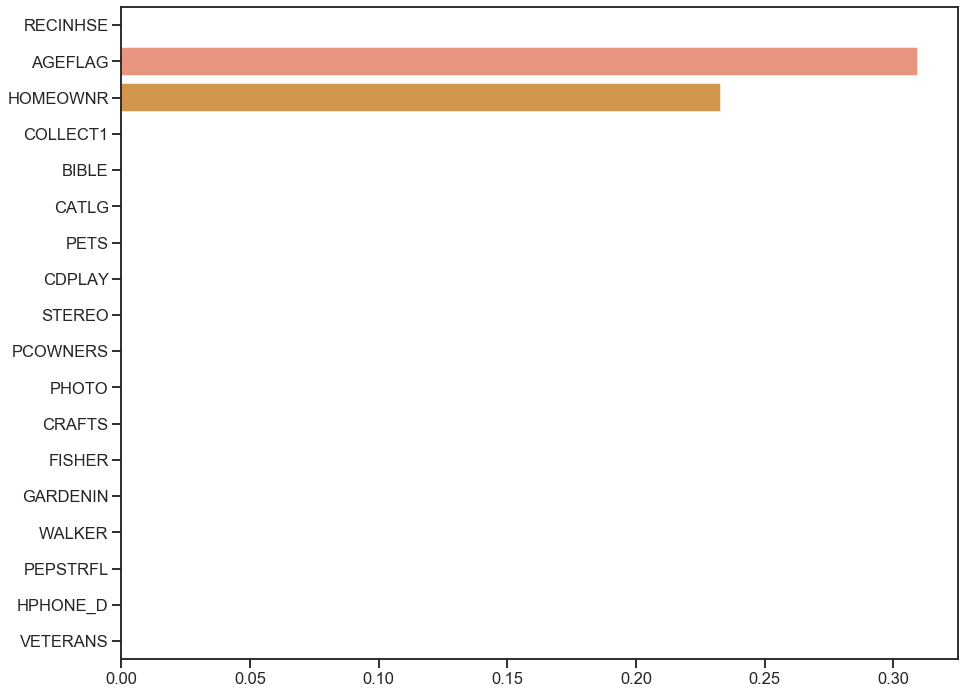

In [20]:
sns.barplot(y=binary.columns, x=1-binary.count()/len(binary.index))
plt.xlabel = "Percentage of missing values."

# Imputation strategies 

## KNN imputation with missingpy
https://github.com/epsilon-machine/missingpy

Olga Troyanskaya, Michael Cantor, Gavin Sherlock, Pat Brown, Trevor Hastie, Robert Tibshirani, David Botstein and Russ B. Altman, Missing value estimation methods for DNA microarrays, BIOINFORMATICS Vol. 17 no. 6, 2001 Pages 520-525

This step requires that we first drop features with more than 80% missing values for the KNNImputer to work.

Best results with k=3: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4959387/

The challenge with KNN imputation it that the algorithm first builds a `n` x `n` distance matrix. 
For the dataset at hand, this means 95412^2, which is a substantial amount of memory (73 GB, to be precise).

In [21]:
bits = 95412**2*64
bytes = bits/8
gb = bytes * 1e-9
print("Memory requriement for distance matrix: {} GB".format(gb))

Memory requriement for distance matrix: 72.827597952 GB


Since this amount of memory is not available, this method cannot be considered

## Iterative imputation with fancyimpute

Iterative imputation takes each feature with missing values as the dependent variable in turn, using the other $m-1$ features to model the missing values through OLS. Data has to be normalized before.

Several iterations are run on the data, improving on the predictions at each iteration.

Unfortunately, this method is unable to preserve the data types in the original data. Binary features and other integer features become float.

Except for the coordinates, no values are smaller than zero in the data set before imputation. After imputation, many features have negative values.

It is possible that a lot of noise is being introduced in the data, making later model training more difficult.

In [22]:
from fancyimpute import IterativeImputer
from sklearn.preprocessing import StandardScaler

In [23]:
imp_iter = IterativeImputer(n_iter=5,
                           initial_strategy="median",
                           n_nearest_features=200, # the 200 most correlated features are used, speeds up computation.
                           random_state=Config.get("random_seed"),
                           verbose=1)

scaler = StandardScaler()

imputed_iterative = imp_iter.fit_transform(scaler.fit_transform(numeric["data"]))

/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


[IterativeImputer] Completing matrix with shape (95412, 653)
[IterativeImputer] Ending imputation round 1/5, elapsed time 124.77
[IterativeImputer] Ending imputation round 2/5, elapsed time 250.47
[IterativeImputer] Ending imputation round 3/5, elapsed time 375.31
[IterativeImputer] Ending imputation round 4/5, elapsed time 499.72
[IterativeImputer] Ending imputation round 5/5, elapsed time 625.43


In [24]:
imputed_iterative = pd.DataFrame(data=imputed_iterative, columns = numeric["data"].columns, index=numeric["data"].index)

In [25]:
imputed_iterative.isna().sum().sum() # Check that all missing values are imputed

0

Features with negative values *before* imputation:

In [26]:
numeric["data"].loc[:,(numeric["data"] < 0.0).apply(np.count_nonzero)> 0]

,ZIP_latitude,ZIP_longitude
CONTROLN,,
95515,41.833205,-89.737983
148535,34.281486,-118.556005
15078,36.382016,-80.756218
172556,39.259087,-121.776559
7112,25.659877,-80.358354
47784,34.535452,-86.971226
62117,41.449152,-85.275111
109359,30.348118,-93.203600
75768,42.912628,-95.251445


Features with negative values *after* imputation:

In [27]:
imputed_iterative.loc[:,(imputed_iterative < 0.0).apply(np.count_nonzero) > 0]

,RECINHSE,AGE,AGEFLAG,HOMEOWNR,NUMCHLD,INCOME,WEALTH1,HIT,MBCRAFT,MBBOOKS,...,RFA_24R_P,RFA_24R_S,RFA_24R_U,RFA_24R_nan,DOMAINUrbanicity_C,DOMAINUrbanicity_R,DOMAINUrbanicity_S,DOMAINUrbanicity_T,DOMAINUrbanicity_U,DOMAINUrbanicity_nan
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,-0.274885,-0.096714,-2.605963,-0.195753,-0.432172,-0.054193,-0.091474,-0.356881,-0.213782,-0.458035,...,-0.099643,2.384378,-0.016189,-0.795410,-0.509915,-0.511563,-0.546200,1.971334,-0.382289,-0.157726
148535,-0.274885,-0.936844,0.385457,0.630768,-0.654133,1.139522,1.332489,1.362283,-0.323551,1.127950,...,-0.099643,-0.419397,-0.016189,-0.795410,-0.509915,-0.511563,1.830831,-0.507271,-0.382289,-0.157726
15078,-0.274885,0.302120,0.287832,-1.585369,-0.736596,-0.477775,-1.584597,-0.141985,-0.323551,-0.069692,...,-0.099643,2.384378,-0.016189,-0.795410,-0.509915,1.954795,-0.546200,-0.507271,-0.382289,-0.157726
172556,-0.274885,0.503379,0.385457,-1.585369,-0.632833,-1.555973,-0.490690,-0.141985,-0.323551,-0.668513,...,-0.099643,-0.419397,-0.016189,1.257214,-0.509915,1.954795,-0.546200,-0.507271,-0.382289,-0.157726
7112,3.637887,0.983454,0.385457,0.630768,-0.654133,-0.477775,-1.219961,6.089983,1.804028,4.720877,...,-0.099643,-0.419397,-0.016189,-0.795410,-0.509915,-0.511563,1.830831,-0.507271,-0.382289,-0.157726
47784,-0.274885,-0.609541,-2.605952,-0.119909,-0.316649,0.234639,0.320137,-0.356881,-0.281415,-0.426261,...,-0.099643,-0.419397,-0.016189,-0.795410,-0.509915,-0.511563,-0.546200,1.971334,-0.382289,-0.157726
62117,-0.274885,-1.416919,0.385457,0.630768,-0.654133,0.061324,0.238582,-0.356881,0.077096,-0.342277,...,-0.099643,-0.419397,-0.016189,-0.795410,-0.509915,-0.511563,-0.546200,1.971334,-0.382289,-0.157726
109359,-0.274885,-0.228625,-0.071945,-1.585369,-0.467831,-1.016874,1.332489,-0.249433,-0.323551,-0.668513,...,-0.099643,-0.419397,-0.016189,-0.795410,-0.509915,-0.511563,-0.546200,1.971334,-0.382289,-0.157726
75768,-0.274885,0.704697,0.191534,-1.585369,-0.730987,-0.477775,-1.219961,-0.356881,-0.136452,-0.369106,...,-0.099643,-0.419397,-0.016189,-0.795410,-0.509915,1.954795,-0.546200,-0.507271,-0.382289,-0.157726


### Study of the variance in imputed data sets

In order to assess the variance introduced through imputation, we impute the data set 5 times and study the resulting variance. Also, the final data frame persisted will be the mean from these 5 imputations. This is in effect how R's package `mice` does iterative imputation. It returns all imputed data frames so that the variance in the predictions due to imputation can be determined.

For the data at hand, this is very expensive because of the size of the data, as can be seen from the debug output below. Times are given in seconds.

In [28]:
X_incomplete = scaler.transform(numeric["data"])

n_imputations = 5
X_completed = []
for i in range(n_imputations):
    imputer = IterativeImputer(n_iter=5,
                               sample_posterior=True,
                               random_state=i,
                               n_nearest_features=100,
                               initial_strategy="median",
                               verbose = 2)
    X_completed.append(imputer.fit_transform(X_incomplete))

X_completed_mean = np.mean(X_completed, 0)
X_completed_std = np.std(X_completed, 0)

/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


[IterativeImputer] Completing matrix with shape (95412, 653)
[IterativeImputer] Ending imputation round 1/5, elapsed time 58.75
[IterativeImputer] Ending imputation round 2/5, elapsed time 116.39
[IterativeImputer] Ending imputation round 3/5, elapsed time 175.29
[IterativeImputer] Ending imputation round 4/5, elapsed time 301.76
[IterativeImputer] Ending imputation round 5/5, elapsed time 484.81


/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


[IterativeImputer] Completing matrix with shape (95412, 653)
[IterativeImputer] Ending imputation round 1/5, elapsed time 188.47
[IterativeImputer] Ending imputation round 2/5, elapsed time 369.50
[IterativeImputer] Ending imputation round 3/5, elapsed time 549.57
[IterativeImputer] Ending imputation round 4/5, elapsed time 714.59
[IterativeImputer] Ending imputation round 5/5, elapsed time 883.74


/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


[IterativeImputer] Completing matrix with shape (95412, 653)
[IterativeImputer] Ending imputation round 1/5, elapsed time 168.02
[IterativeImputer] Ending imputation round 2/5, elapsed time 310.94
[IterativeImputer] Ending imputation round 3/5, elapsed time 383.24
[IterativeImputer] Ending imputation round 4/5, elapsed time 454.43
[IterativeImputer] Ending imputation round 5/5, elapsed time 555.93


/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


[IterativeImputer] Completing matrix with shape (95412, 653)
[IterativeImputer] Ending imputation round 1/5, elapsed time 179.80
[IterativeImputer] Ending imputation round 2/5, elapsed time 374.18
[IterativeImputer] Ending imputation round 3/5, elapsed time 560.20
[IterativeImputer] Ending imputation round 4/5, elapsed time 735.14
[IterativeImputer] Ending imputation round 5/5, elapsed time 914.44


/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/data/anaconda/envs/py36/lib/python3.6/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


[IterativeImputer] Completing matrix with shape (95412, 653)
[IterativeImputer] Ending imputation round 1/5, elapsed time 167.11
[IterativeImputer] Ending imputation round 2/5, elapsed time 325.32
[IterativeImputer] Ending imputation round 3/5, elapsed time 485.37
[IterativeImputer] Ending imputation round 4/5, elapsed time 555.10
[IterativeImputer] Ending imputation round 5/5, elapsed time 627.96


In [29]:
X_completed_mean

array([[-0.27488483, -0.09671395, -2.39278436, ...,  1.97133397,
        -0.38228937, -0.15772617],
       [-0.27488483, -0.93684422,  0.38545688, ..., -0.50727072,
        -0.38228937, -0.15772617],
       [-0.27488483,  0.74079567,  0.41638076, ..., -0.50727072,
        -0.38228937, -0.15772617],
       ...,
       [-0.27488483, -0.09671395, -2.57774191, ..., -0.50727072,
        -0.38228937, -0.15772617],
       [ 3.63788723, -0.21673256,  0.38545688, ..., -0.50727072,
        -0.38228937, -0.15772617],
       [ 3.63788723,  1.10347214,  0.38545688, ..., -0.50727072,
        -0.38228937, -0.15772617]])

In [30]:
X_completed_std

array([[0.        , 0.        , 0.61822703, ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.94651725, 0.39987326, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.36364447, ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

The standard deviation is scaled to $[0,1]$ to make it comparable

In [31]:
from sklearn.preprocessing import MinMaxScaler
mmsc = MinMaxScaler()
X_completed_std_norm = mmsc.fit_transform(X_completed_std)

In [32]:
X_completed_std_norm.shape

(95412, 653)

Shown is the scaled standard deviation per feature, anaolgous to the plot shown at the top of this notebook. Dark regions have a high 

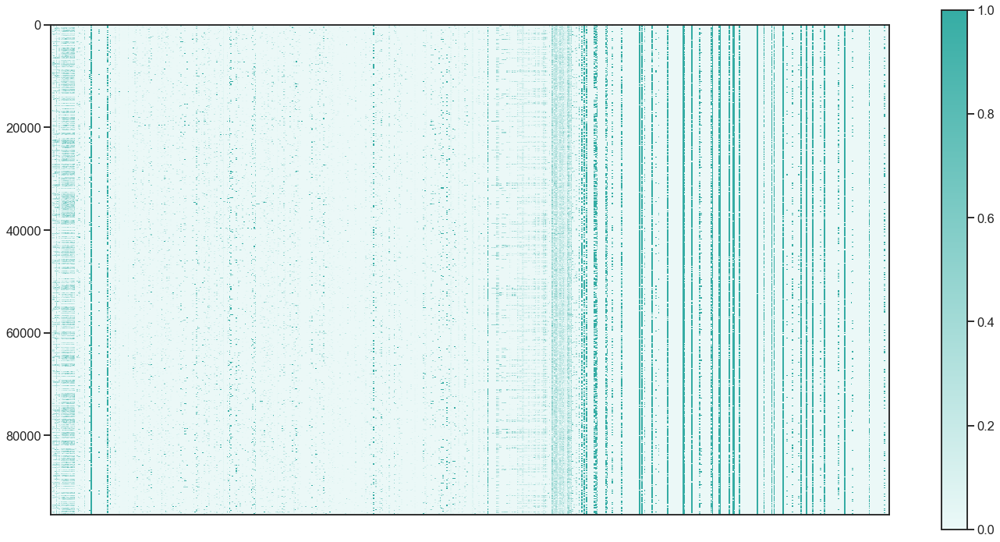

In [33]:
import seaborn as sns
plt.rcParams['figure.figsize'] = (20, 10)
plt.imshow(X_completed_std_norm, aspect=0.004, cmap=Config.get("seq_color_map"))
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off
plt.colorbar()
save_fig("imputation-sd-scaled")

A new dataset with the average from 5 rounds of imputation is saved:

In [34]:
imputed_iterative_mean_of_five = numeric.copy()
imputed_iterative_mean_of_five["data"] = pd.DataFrame(data=X_completed_mean, columns = numeric["data"].columns, index=numeric["data"].index)

with open(pathlib.Path(Config.get("df_store"), "Xy_imputed_iterative_mean_of_5.pd.pkl"), "wb") as of:
    pickle.dump(imputed_iterative_mean_of_five, of)

## Simple Imputation

A straightforward approach was implemented as follows. This is also the imputation strategy implemented in `kdd98`. It was decided to use this approach because the iterative impuation changed the nature of the data and also because it is expensive to run.

### Categorical features

No imputation was performed. Instead, a new indicator level (`nan`) for missing values was added at the time of encoding (one-hot / binary) of the features. This allows for the models to pick up patterns that exist because of the missingness of values.

### Binary features 

Binary features were imputed with the most frequent value (the mode) prevalent in the data. Since, as shown below, the mode always corresponds to the median, these features were treated together with the remaining numeric["data"] features.

In [35]:
numeric = data_provider.numeric_data

In [36]:
for f in binary.columns:
    print("Feature {} has median {} and mode {}".format(f, binary[f].median(), binary[f].mode()[0]))

Feature RECINHSE has median 0.0 and mode 0
Feature AGEFLAG has median 1.0 and mode 1
Feature HOMEOWNR has median 1.0 and mode 1
Feature COLLECT1 has median 0.0 and mode 0
Feature BIBLE has median 0.0 and mode 0
Feature CATLG has median 0.0 and mode 0
Feature PETS has median 0.0 and mode 0
Feature CDPLAY has median 0.0 and mode 0
Feature STEREO has median 0.0 and mode 0
Feature PCOWNERS has median 0.0 and mode 0
Feature PHOTO has median 0.0 and mode 0
Feature CRAFTS has median 0.0 and mode 0
Feature FISHER has median 0.0 and mode 0
Feature GARDENIN has median 0.0 and mode 0
Feature WALKER has median 0.0 and mode 0
Feature PEPSTRFL has median 0.0 and mode 0
Feature HPHONE_D has median 1.0 and mode 1
Feature VETERANS has median 0.0 and mode 0


### numeric["data"] features

numeric["data"] features are imputed using the median since many features are highly skewed.

In [37]:
from sklearn.impute import SimpleImputer

imp_median = SimpleImputer(missing_values=np.nan, strategy='median')
X_imputed = imp_median.fit_transform(numeric["data"])
X_imputed = pd.DataFrame(data=X_imputed, index = numeric["data"].index, columns=numeric["data"].columns)
numeric["data"] = X_imputed

This data set can be retrieved from kdd98:

In [38]:
median_imputed = data_provider.imputed_data